<a href="https://colab.research.google.com/github/JasonL888/Vision_Experiments/blob/main/yolo_livestream.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Step 1: Install required packages
!pip install ultralytics opencv-python

In [ ]:
# Step 2: Import libraries
import cv2
from ultralytics import YOLO
import math

In [ ]:
# Step 3: Load the YOLOv8 model (using the nano version for speed)
model = YOLO('yolov8n.pt')

In [ ]:
# Step 4: Define class names (COCO dataset classes)
classNames = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat",
              "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat",
              "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella",
              "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat",
              "baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup",
              "fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli",
              "carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed",
              "diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone",
              "microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors",
              "teddy bear", "hair drier", "toothbrush"
              ]

In [ ]:
# Step 5: Specify a public webcam stream URL
video_url = "https://cdn-004.whatsupcams.com/hls/hr_pula01.m3u8"

In [ ]:
max_num_images = 2
num_images = 0


0: 384x640 5 persons, 1 car, 1 stop sign, 55.8ms
Speed: 4.5ms preprocess, 55.8ms inference, 151.8ms postprocess per image at shape (1, 3, 384, 640)


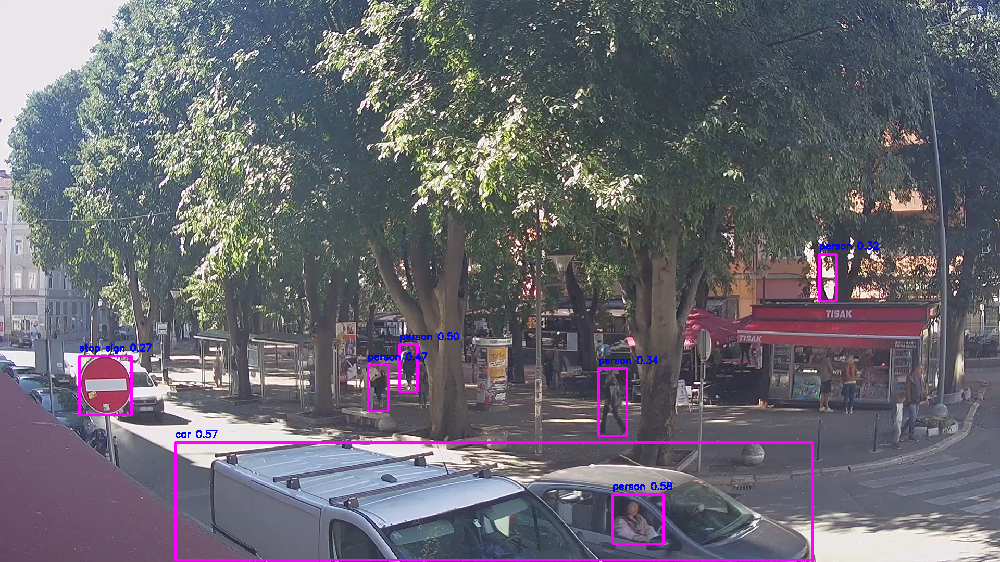


0: 384x640 5 persons, 3 cars, 12.2ms
Speed: 6.9ms preprocess, 12.2ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)


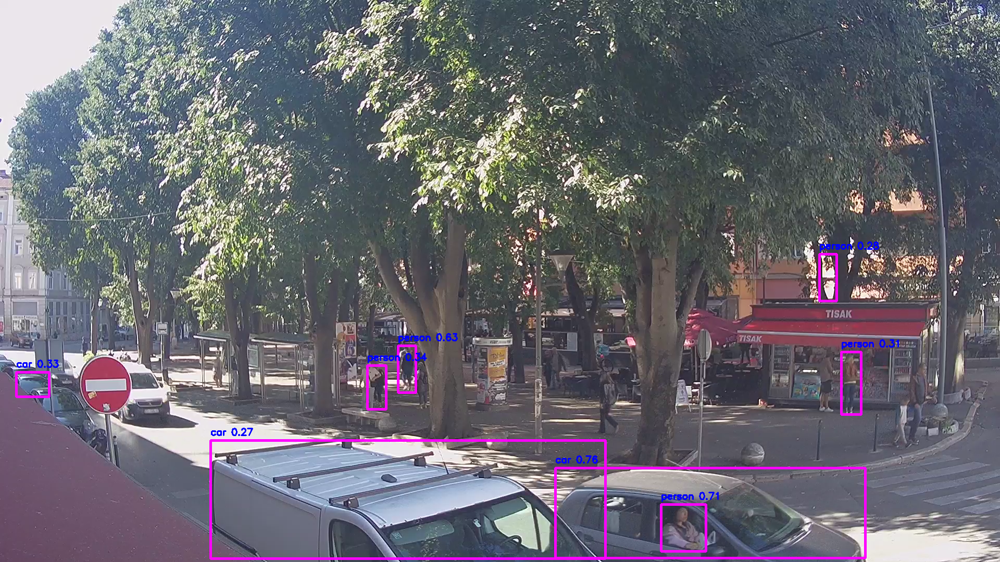


0: 384x640 5 persons, 3 cars, 8.9ms
Speed: 7.9ms preprocess, 8.9ms inference, 6.2ms postprocess per image at shape (1, 3, 384, 640)


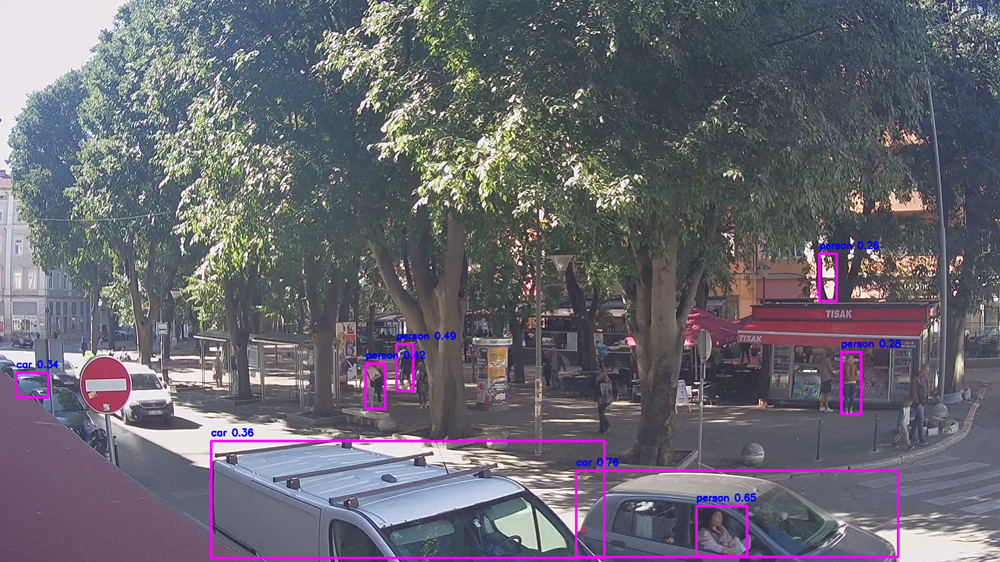


0: 384x640 4 persons, 4 cars, 11.6ms
Speed: 6.8ms preprocess, 11.6ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


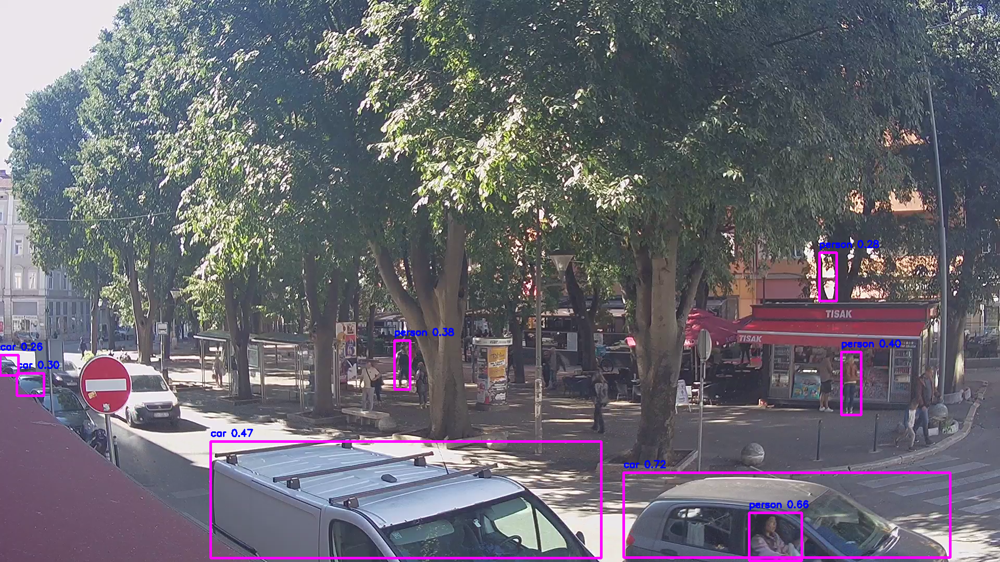


0: 384x640 4 persons, 5 cars, 1 stop sign, 9.1ms
Speed: 9.3ms preprocess, 9.1ms inference, 6.8ms postprocess per image at shape (1, 3, 384, 640)


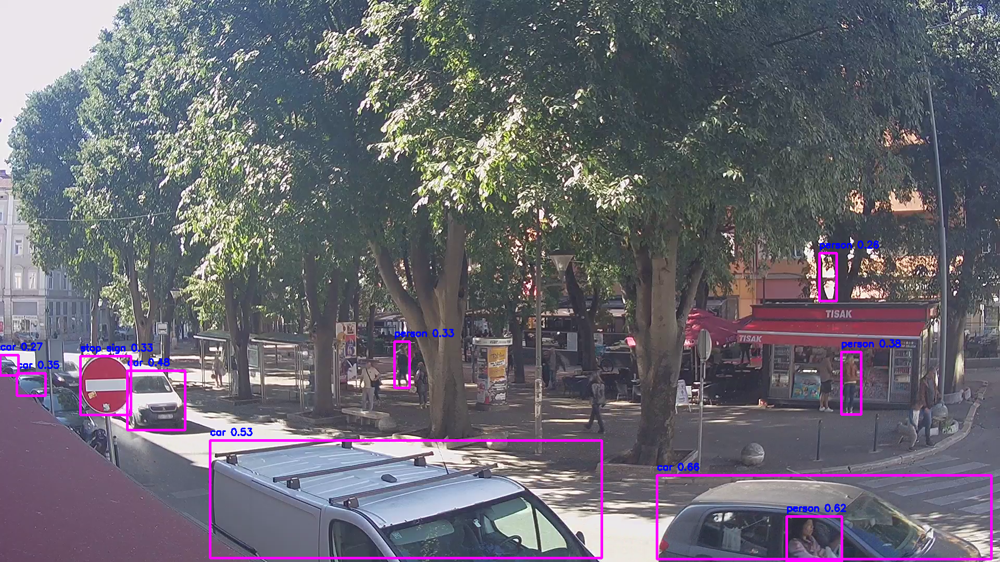

In [ ]:
# Step 6: Start video capture and processing
cap = cv2.VideoCapture(video_url)

while True:
    success, img = cap.read()
    if not success:
        break

    # Run YOLOv8 inference on the frame
    results = model(img, stream=True)

    # Process detections
    for r in results:
        boxes = r.boxes
        for box in boxes:
            # Get bounding box coordinates
            x1, y1, x2, y2 = box.xyxy[0]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

            # Draw bounding box
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 255), 3)

            # Calculate confidence
            confidence = math.ceil((box.conf[0] * 100)) / 100

            # Get class name
            cls = int(box.cls[0])
            class_name = classNames[cls]

            # Prepare detection text
            label = f'{class_name} {confidence:.2f}'

            # Put label on image
            org = (x1, y1 - 10)  # Position text above the box
            font = cv2.FONT_HERSHEY_SIMPLEX
            fontScale = 0.6
            color = (255, 0, 0)
            thickness = 2
            cv2.putText(img, label, org, font, fontScale, color, thickness)

    # Display the output (Colab requires special handling for display)
    from google.colab.patches import cv2_imshow
    cv2_imshow(img)
    num_images += 1
    if (num_images >= max_num_images) or (cv2.waitKey(1) == ord('q')):
        break

cap.release()
cv2.destroyAllWindows()